In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import altair as alt
import geopandas as gpd

alt.data_transformers.disable_max_rows()
pd.set_option('display.max_columns', None)

# Load data

In [2]:
# Paris
url_listings_paris = 'https://data.insideairbnb.com/france/ile-de-france/paris/2024-03-16/visualisations/listings.csv'
url_reviews_paris = 'https://data.insideairbnb.com/france/ile-de-france/paris/2024-03-16/visualisations/reviews.csv'
url_listings_detailed_paris = 'https://data.insideairbnb.com/france/ile-de-france/paris/2024-03-16/data/listings.csv.gz'

# Bordeaux
url_listings_bordeaux = 'https://data.insideairbnb.com/france/nouvelle-aquitaine/bordeaux/2024-03-23/visualisations/listings.csv'
url_reviews_bordeaux = 'https://data.insideairbnb.com/france/nouvelle-aquitaine/bordeaux/2024-03-23/data/reviews.csv.gz'
url_listings_detailed_bordeaux = 'https://data.insideairbnb.com/france/nouvelle-aquitaine/bordeaux/2024-03-23/data/listings.csv.gz'
url_neighbourhoods_bordeaux = 'https://data.insideairbnb.com/france/nouvelle-aquitaine/bordeaux/2024-03-23/visualisations/neighbourhoods.geojson'

# Lyon
url_listings_lyon = 'https://data.insideairbnb.com/france/auvergne-rhone-alpes/lyon/2024-03-23/visualisations/listings.csv'
url_reviews_lyon = 'https://data.insideairbnb.com/france/auvergne-rhone-alpes/lyon/2024-03-23/visualisations/reviews.csv'
url_listings_detailed_lyon = 'https://data.insideairbnb.com/france/auvergne-rhone-alpes/lyon/2024-03-23/data/listings.csv.gz'

In [3]:
listings_paris = pd.read_csv(url_listings_paris)
listings_bordeaux = pd.read_csv(url_listings_bordeaux)
listings_lyon = pd.read_csv(url_listings_lyon)

In [4]:
df = pd.read_csv(url_listings_bordeaux)
df.head(3)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,222887,"Bordeaux Terrace - amazing view, air-con, elev...",1156398,Suzanna,Bordeaux,Bordeaux Sud,44.836102,-0.566395,Entire home/apt,203.0,3,85,2024-01-22,0.57,4,265,21,3306300031048
1,247452,"Cosy apartment ,barbecue, pool",959918,Krista,Saint-Mdard-en-Jalles,Saint-Mdard-en-Jalles,44.858900,-0.727350,Entire home/apt,95.0,2,66,2024-03-01,0.45,1,151,11,NaN
2,317273,"Bordeaux City Gardens - large 1 bd, park adjacent",1156398,Suzanna,Bordeaux,Chartrons - Grand Parc - Jardin Public,44.847801,-0.581046,Entire home/apt,171.0,3,56,2024-02-21,0.48,4,229,15,33063001366CB


In [5]:
import ast

detailed_listings_bordeaux = pd.read_csv(url_listings_detailed_bordeaux)

# Format
detailed_listings_bordeaux['price'] = detailed_listings_bordeaux['price'].replace({'\$': '', ',': ''}, regex=True).astype(float)
detailed_listings_bordeaux['amenities'] = detailed_listings_bordeaux['amenities'].apply(lambda x: ast.literal_eval(x))
detailed_listings_bordeaux['host_since'] = pd.to_datetime(detailed_listings_bordeaux['host_since'])
detailed_listings_bordeaux['days_since_host'] = (pd.Timestamp('today') - detailed_listings_bordeaux['host_since']).dt.days

detailed_listings_bordeaux.head(3)

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,days_since_host
0,222887,https://www.airbnb.com/rooms/222887,20240323020910,2024-03-23,city scrape,"Bordeaux Terrace - amazing view, air-con, elev...",Picture yourself on a 12 metre terrace overloo...,Bordeaux Terrace is ideally situated to visit ...,https://a0.muscache.com/pictures/8f2b210e-3c0e...,1156398,https://www.airbnb.com/users/show/1156398,Suzanna,2011-09-14,"Duras, France","Originally from New Zealand and Australia, I n...",within an hour,100%,98%,t,https://a0.muscache.com/im/pictures/user/71aa6...,https://a0.muscache.com/im/pictures/user/71aa6...,Hôtel de Ville - Quinconces,21,31,"['email', 'phone', 'work_email']",t,t,"Bordeaux, Aquitaine, France",Bordeaux Sud,Bordeaux,44.836102,-0.566395,Entire vacation home,Entire home/apt,4,1.0,1 bath,2.0,3.0,"[Hangers, Conditioner, Refrigerator, Shampoo, ...",203.0,3,90,3,5,90,90,4.5,90.0,NaN,t,15,29,40,265,2024-03-23,85,21,0,2012-01-04,2024-01-22,4.79,4.79,4.66,4.90,4.96,4.71,4.64,3306300031048,t,4,4,0,0,0.57,4661
1,247452,https://www.airbnb.com/rooms/247452,20240323020910,2024-03-23,city scrape,"Cosy apartment ,barbecue, pool",NaN,NaN,https://a0.muscache.com/pictures/39503733/4b3c...,959918,https://www.airbnb.com/users/show/959918,Krista,2011-08-12,"Bordeaux, France","Hi, I'm Krista, 43 years old, Belgian and livi...",within a few hours,100%,86%,t,https://a0.muscache.com/im/users/959918/profil...,https://a0.muscache.com/im/users/959918/profil...,NaN,1,1,"['email', 'phone']",t,f,NaN,Saint-Mdard-en-Jalles,Saint-Mdard-en-Jalles,44.858900,-0.727350,Entire rental unit,Entire home/apt,4,1.0,1 bath,2.0,2.0,"[Bathtub, Hangers, Bidet, Free parking on prem...",95.0,2,30,2,2,30,30,2.0,30.0,NaN,t,29,59,89,151,2024-03-23,66,11,1,2012-04-23,2024-03-01,4.82,4.78,4.78,4.97,4.91,4.52,4.70,NaN,f,1,1,0,0,0.45,4694
2,317273,https://www.airbnb.com/rooms/317273,20240323020910,2024-03-23,city scrape,"Bordeaux City Gardens - large 1 bd, park adjacent","A spacious one bedroom apartment, (93 sq metre...",Bordeaux's famous Jardin Public is at the end ...,https://a0.muscache.com/pictures/miso/Hosting-...,1156398,https://www.airbnb.com/users/show/1156398,Suzanna,2011-09-14,"Duras, France","Originally from New Zealand and Australia, I n...",within an hour,100%,98%,t,https://a0.muscache.com/im/pictures/user/71aa6...,https://a0.muscache.com/im/pictures/user/71aa6...,Hôtel de Ville - Quinconces,21,31,"['email', 'phone', 'work_email']",t,t,"Bordeaux, Nouvelle-Aquitaine, France",Chartrons - Grand Parc - Jardin Public,Bordeaux,44.847801,-0.581046,Entire rental unit,Entire home/apt,2,1.5,1.5 baths,1.0,2.0,"[Hangers, Refrigerator, Shampoo, High chair, D...",171.0,3,90,3,3,90,90,3.0,90.0,NaN,t,7,12,26,229,2024-03-23

# Bar graphs

In [6]:
import altair as alt

# Filter out the data points with bin value of 0
filtered_data = df[df['availability_365'] > 0]

alt.Chart(filtered_data).mark_bar().encode(
    alt.X("availability_365:Q", bin=alt.Bin(step=1)),
    y='count()',
    tooltip=['availability_365:Q', 'count()']  # Add tooltip encoding
).properties(
    title="Distribution of Availability Over 365 Days (Excluding 0 Bin)",
    width=800  # Adjust the width of the plot
).interactive()


alt.Chart(...)

In [7]:
df_filtered = df[df["price"] < 1000]

alt.Chart(df_filtered).mark_bar().encode(
    alt.X("price:Q", bin=alt.Bin(step=10), scale=alt.Scale(domain=(0, 1000))),
    y='count()',
).properties(
    title="Distribution of Prices"
)


alt.Chart(...)

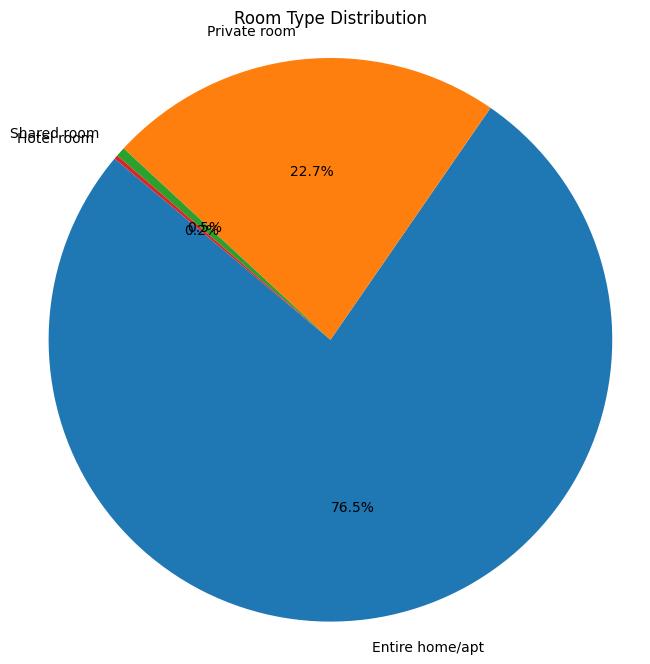

In [8]:
import matplotlib.pyplot as plt

# Group the data by room type and calculate the counts
room_counts = detailed_listings_bordeaux['room_type'].value_counts()

# Create a pie chart
plt.figure(figsize=(8, 8))
plt.pie(room_counts, labels=room_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Room Type Distribution')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.show()


# Map

In [9]:
import pandas as pd
import altair as alt
import json

# Define the desired range for the x and y axes
longitude_min, longitude_max = -0.85, -0.40  # Example range for longitude
latitude_min, latitude_max = 44.6, 45.05      # Example range for latitude

# Points layer for Airbnb listings
points = alt.Chart(df).mark_circle(size=60).encode(
    x=alt.X('longitude:Q', scale=alt.Scale(domain=[longitude_min, longitude_max])),
    y=alt.Y('latitude:Q', scale=alt.Scale(domain=[latitude_min, latitude_max])),
    color='neighbourhood:N',
    tooltip=['name', 'neighbourhood', 'price']
).properties(
    title='Geographical Distribution of Airbnb Listings in Bordeaux',
    width=800,
    height=800
).interactive()

# Combine the base map and points layers
chart = alt.layer(points).configure_view(
    stroke=None
).interactive()

chart

alt.LayerChart(...)

In [10]:
import folium

# Create a map centered on Bordeaux
map_bordeaux = folium.Map(location=[44.837789, -0.579180], zoom_start=12)

# Iterate over the rows of the DataFrame containing the points
for index, row in df.iterrows():
    # Get the latitude and longitude of the point
    lat = row['latitude']
    lon = row['longitude']
    
    # Get the price of the point
    price = row['price']
    
    # Define the color of the marker based on the price
    if price < 200:
        color = 'green'
    elif price < 400:
        color = 'orange'
    elif price < 600:
        color = 'red'
    elif price >= 800:
        color = 'pink'
    else:
        color = 'black'
    
    # Create a circle marker (simple dot) and add it to the map
    folium.CircleMarker(location=[lat, lon], radius=1, color=color, fill=True, fill_color=color).add_to(map_bordeaux)

# Display the map
map_bordeaux


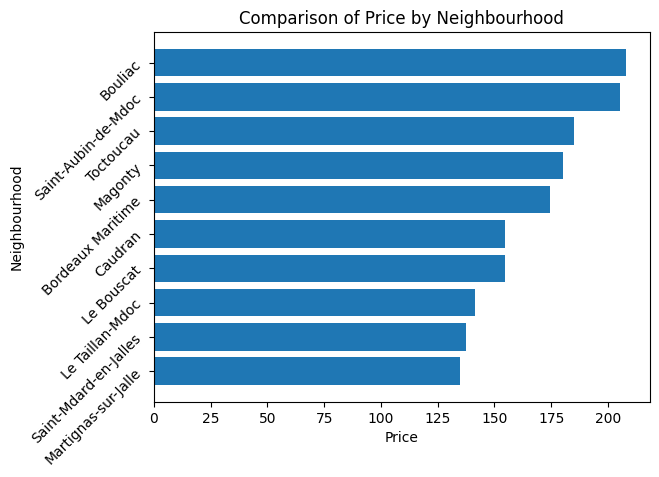

In [11]:
# Sort the DataFrame by 'price' column in descending order
mean_prices = df.groupby('neighbourhood')['price'].mean().reset_index()
mean_prices = mean_prices.sort_values(by='price', ascending=True).tail(10)

# Create the horizontal bar plot
plt.barh(mean_prices['neighbourhood'], mean_prices['price'])

# Set the labels and title
plt.xlabel('Price')
plt.ylabel('Neighbourhood')
plt.yticks(rotation=45, ha='right')
plt.title('Comparison of Price by Neighbourhood')

# Display the plot
plt.show()

# Correlations

In [12]:
import altair as alt

# Define the interval size
interval_size = 50

# Filter out data points with prices exceeding $320
filtered_data = detailed_listings_bordeaux[detailed_listings_bordeaux['price'] <= 320]

# Calculate the intervals
filtered_data['interval'] = filtered_data['price'] // interval_size * interval_size

# Group by intervals and calculate median review_scores_rating
grouped_data = filtered_data.groupby('interval')['review_scores_rating'].median().reset_index()

# Define the interval size of the median review scores rating
median_interval_size = interval_size

# Create a scatter plot
scatter_plot = alt.Chart(grouped_data).mark_point().encode(
    x=alt.X('interval:Q', title='Price Interval ($)', scale=alt.Scale(domain=[0, 320])),
    y=alt.Y('review_scores_rating:Q', title='Median Review Scores Rating', scale=alt.Scale(domain=[4.8, 5])),
    tooltip=['interval:Q', 'review_scores_rating:Q']
).properties(
    width=600,
    height=400,
    title=f"Price Intervals vs Median Review Scores Rating\n(Median Interval: {median_interval_size})"
).interactive()

# Fit a red line through the filtered data points
red_line = scatter_plot.transform_regression(
    'interval', 'review_scores_rating',  # Specify the x and y variables
    method='poly',  # Choose the regression method (polynomial regression)
    order=1,  # Set the order of the polynomial
    as_=['interval', 'review_scores_rating']  # Name the new variables created by the regression
).mark_line(color='red')  # Set the color of the line to red

# Combine the scatter plot and the red line
scatter_with_line = (scatter_plot + red_line)

# Show the scatter plot with the red line
scatter_with_line


/tmp/ipykernel_8548/4113209503.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['interval'] = filtered_data['price'] // interval_size * interval_size


alt.LayerChart(...)

In [13]:
import altair as alt

# Calculate the number of amenities for each listing
detailed_listings_bordeaux['num_amenities'] = detailed_listings_bordeaux['amenities'].apply(len)

# Group the data by the number of amenities and calculate the mean review score for each group
grouped_data = detailed_listings_bordeaux.groupby('num_amenities')['review_scores_rating'].mean().reset_index()

# Create a scatter plot with a regression line
scatter_plot = alt.Chart(grouped_data).mark_point().encode(
    x='num_amenities:Q',
    y=alt.Y('review_scores_rating:Q', scale=alt.Scale(domain=[4.5, 5])),
    tooltip=['num_amenities:Q', 'review_scores_rating:Q']
).properties(
    width=600,
    height=400,
    title="Correlation between Number of Amenities and Mean Review Scores"
).interactive() 

# Add a regression line to the scatter plot
regression_line = scatter_plot.transform_regression('num_amenities', 'review_scores_rating').mark_line(color='red')

# Show the scatter plot with the regression line
scatter_plot + regression_line


alt.LayerChart(...)

In [14]:
import altair as alt
import pandas as pd
from geopy.distance import geodesic
import numpy as np

# Coordinates of Place de la Bourse
bourse_coords = (44.8413, -0.5720)

# Interval size in kilometers
interval_size = 0.2

# Calculate distance from each Airbnb listing to Place de la Bourse
df['distance_to_bourse'] = df.apply(lambda row: geodesic((row['latitude'], row['longitude']), bourse_coords).kilometers, axis=1)

# Create distance intervals (bins) with a step of `interval_size`
df['distance_bin'] = (df['distance_to_bourse'] // interval_size) * interval_size

# Group by distance intervals and calculate mean price for each interval
grouped_data = df.groupby('distance_bin')['price'].mean().reset_index()

# Filter data for distances between 0 and 7 km
filtered_data = grouped_data[(grouped_data['distance_bin'] >= 0) & (grouped_data['distance_bin'] <= 7)]

# Create a scatter plot
scatter_plot = alt.Chart(filtered_data).mark_point().encode(
    x=alt.X('distance_bin:Q', title='Distance to Place de la Bourse (km)', scale=alt.Scale(domain=[0, 7])),  # Set the x-axis range
    y=alt.Y('price:Q', title='Mean Price (€)', scale=alt.Scale(domain=[90, 140])),  # Set the y-axis range
    tooltip=['distance_bin:Q', 'price:Q']
).properties(
    width=600,
    height=400,
    title=f"Mean Price of Airbnb Listings vs. Distance to Place de la Bourse (Interval Size: {interval_size} km)"
).interactive()

# Add a regression line to the scatter plot
regression_line = scatter_plot.transform_regression(
    'distance_bin', 'price'
).mark_line(color='red')

# Calculate the mean price interval lines
mean_interval_lines = []
for index, row in filtered_data.iterrows():
    mean_interval_lines.append(
        alt.Chart(pd.DataFrame([row])).mark_rule(color='blue', strokeDash=[3, 3]).encode(
            x='distance_bin:Q',
            y='price:Q',
            y2='mean(price):Q'
        )
    )

# Combine scatter plot, regression line, and mean interval lines
combined_plot = scatter_plot + regression_line + alt.layer(*mean_interval_lines)

# Show the combined plot
combined_plot


alt.LayerChart(...)

In [15]:
import altair as alt
import pandas as pd
from geopy.distance import geodesic

# Coordinates of Place de la Bourse
bourse_coords = (44.8413, -0.5720)

# Calculate distance from each Airbnb listing to Place de la Bourse
detailed_listings_bordeaux['distance_to_bourse'] = detailed_listings_bordeaux.apply(lambda row: geodesic((row['latitude'], row['longitude']), bourse_coords).kilometers, axis=1)

# Define the interval size
interval_size = 0.5

# Calculate the intervals
detailed_listings_bordeaux['distance_interval'] = detailed_listings_bordeaux['distance_to_bourse'] // interval_size * interval_size

# Group by distance intervals and calculate mean number of beds for each interval
grouped_data = detailed_listings_bordeaux.groupby('distance_interval')['beds'].mean().reset_index()

# Calculate the start and end points for each interval line
grouped_data['start'] = grouped_data['distance_interval']
grouped_data['end'] = grouped_data['distance_interval'] + interval_size

# Create a rule plot for the interval lines (mean lines) with blue color
rule_plot = alt.Chart(grouped_data).mark_rule(color='blue').encode(
    x=alt.X('start:Q', title='Distance to Place de la Bourse (km)', scale=alt.Scale(domain=[0, 18])),  # Set the x-axis range
    x2='end:Q',
    y=alt.Y('beds:Q', title='Mean Number of Beds', scale=alt.Scale(domain=[1.6, 3])),  # Set the y-axis range
    tooltip=['distance_interval:Q', 'beds:Q']
).properties(
    width=600,
    height=400,
    title="Mean Number of Beds vs. Distance to Place de la Bourse (Interval of 0.5 km)"
).interactive()

# Fit a line through the data points (regression line) with red color
line_fit = alt.Chart(grouped_data).transform_regression(
    'distance_interval', 'beds', method='linear'
).mark_line(color='red').encode(
    x='distance_interval',
    y='beds'
)

# Combine rule plot and line fit
combined_plot = rule_plot + line_fit

# Show the combined plot
combined_plot


alt.LayerChart(...)

In [16]:
# Step 1: Group by host_id and calculate the number of listings and average communication score per host
host_stats = detailed_listings_bordeaux.groupby('host_id').agg(
    num_listings=('host_id', 'size'),
    avg_communication_score=('review_scores_communication', 'mean')
).reset_index()

# Step 2: Group by the number of listings to calculate the mean communication score
listing_stats = host_stats.groupby('num_listings').agg(
    mean_communication_score=('avg_communication_score', 'mean'),
    count=('avg_communication_score', 'count')  # Count the number of elements
).reset_index()

# Filter data for the first 8 points
first_8_points = listing_stats[listing_stats['num_listings'] <= 8]

# Create a scatter plot for the first 8 points
scatter_plot_first_8 = alt.Chart(first_8_points).mark_point().encode(
    x=alt.X('num_listings:Q', title='Number of Listings', scale=alt.Scale(domain=[0, 8])),  # Adjust domain to [0, 8]
    y=alt.Y('mean_communication_score:Q', title='Average Communication Score', scale=alt.Scale(domain=[4.7, 5])),
    tooltip=['num_listings:Q', alt.Tooltip('mean_communication_score:Q', format=".2f"), alt.Tooltip('count:Q', title='Count')]  # Include count in tooltip
)

# Fit a red regression line to the first 8 points
regression_line_first_8 = scatter_plot_first_8.transform_regression(
    'num_listings', 'mean_communication_score'
).mark_line(color='red')

# Create a scatter plot for all points
scatter_plot_all = alt.Chart(listing_stats).mark_point(color='grey', opacity=0.5).encode(
    x=alt.X('num_listings:Q', title='Number of Listings', scale=alt.Scale(domain=[0, 8])),  # Adjust domain to [0, 8]
    y=alt.Y('mean_communication_score:Q', title='Average Communication Score', scale=alt.Scale(domain=[4.7, 5])),
    tooltip=['num_listings:Q', alt.Tooltip('mean_communication_score:Q', format=".2f"), alt.Tooltip('count:Q', title='Count')]  # Include count in tooltip
)

# Combine scatter plots and regression line
combined_plot = (scatter_plot_first_8 + scatter_plot_all + regression_line_first_8).properties(
    width=600,
    height=400,
    title="Number of Listings vs Mean Communication Score"
).interactive()

# Show the combined plot
combined_plot


alt.LayerChart(...)

In [17]:
# Select relevant columns
columns = ['review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness',
           'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value']

# Calculate the correlation matrix
corr_matrix = detailed_listings_bordeaux[columns].corr()

# Melt the correlation matrix for plotting
corr_matrix_melted = corr_matrix.reset_index().melt(id_vars='index')
corr_matrix_melted.columns = ['Variable1', 'Variable2', 'Correlation']

# Round the correlation values to two decimal points
corr_matrix_melted['Correlation'] = corr_matrix_melted['Correlation'].round(2)

# Create the heatmap
heatmap = alt.Chart(corr_matrix_melted).mark_rect().encode(
    x=alt.X('Variable1:N', title=None),
    y=alt.Y('Variable2:N', title=None),
    color=alt.Color('Correlation:Q', scale=alt.Scale(scheme='viridis')),
    tooltip=['Variable1:N', 'Variable2:N', 'Correlation:Q']
).properties(
    width=600,
    height=600,
    title="Correlation Matrix of Review Scores"
)

# Create the text annotations
text = alt.Chart(corr_matrix_melted).mark_text(size=18, color='black').encode(
    x=alt.X('Variable1:N', title=None),
    y=alt.Y('Variable2:N', title=None),
    text=alt.Text('Correlation:Q'),
    tooltip=['Variable1:N', 'Variable2:N', 'Correlation:Q']
)

# Layer the heatmap and text annotations
heatmap_with_text = heatmap + text

# Show the combined plot
heatmap_with_text


alt.LayerChart(...)

In [18]:
import altair as alt

# Define the interval size
interval_size = 500

# Calculate the intervals
detailed_listings_bordeaux['interval'] = detailed_listings_bordeaux['days_since_host'] // interval_size * interval_size

# Group by intervals and calculate mean review_scores_rating
grouped_data = detailed_listings_bordeaux.groupby('interval')['review_scores_rating'].mean().reset_index()

# Create a scatter plot
scatter_plot = alt.Chart(grouped_data).mark_line().encode(
    x=alt.X('interval:Q', title='Days Since Host Started (Interval)'),
    y=alt.Y('review_scores_rating:Q', title='Mean Review Scores Rating', scale=alt.Scale(domain=[4.7, 4.9])),
    tooltip=['interval:Q', 'review_scores_rating:Q']
).properties(
    width=600,
    height=400,
    title=f"Correlation between Days Since Host Started (Interval of {interval_size} days) and Mean Review Scores Rating"
).interactive()

# Show the scatter plot
scatter_plot


alt.Chart(...)

# Pie

# Word analysis 

In [19]:
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string
from wordcloud import WordCloud

In [20]:
def tokenize(text):
    # Get stop words for both English and French
    stop_words_en = set(stopwords.words('english'))
    stop_words_fr = set(stopwords.words('french'))
    punctuation = set(string.punctuation)

    # Combine English and French stop words
    stop_words = stop_words_en.union(stop_words_fr)
    word_tokens = word_tokenize(text)

    # Filter out stop words and punctuation
    filtered_text = [w for w in word_tokens if w.lower() not in stop_words and w not in punctuation]

    return filtered_text

In [21]:
# Tokenize the text
filtered_names = tokenize(' '.join(df["name"].dropna()))
filtered_host_names = tokenize(' '.join(df["host_name"].dropna()))

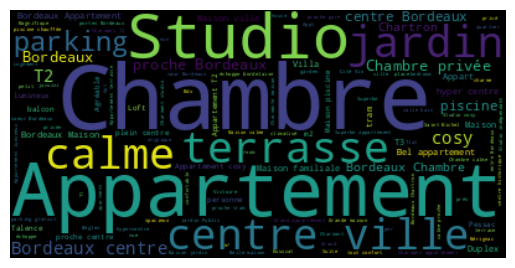

In [22]:
# Generate word cloud
wordcloud = WordCloud().generate(' '.join(filtered_names))

# Display the word cloud
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

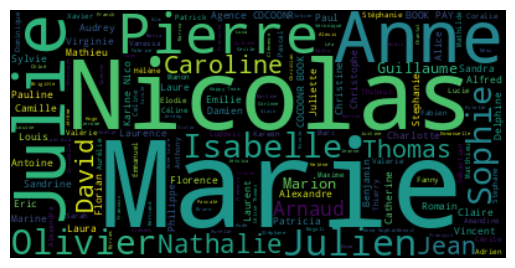

In [23]:
# Generate word cloud
wordcloud = WordCloud().generate(' '.join(filtered_host_names))

# Display the word cloud
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

## Comparison between cities

In [24]:
filtered_host_names_paris = tokenize(' '.join(listings_paris["host_name"].dropna()))
filtered_host_names_bordeaux = tokenize(' '.join(listings_bordeaux["host_name"].dropna()))
filtered_host_names_lyon = tokenize(' '.join(listings_lyon["host_name"].dropna()))

filtered_host_names = filtered_host_names_paris + filtered_host_names_bordeaux + filtered_host_names_lyon

In [25]:
# Function to create bar plot for a given list of names
def create_bar_plot(names, title):
    # Convert list to DataFrame
    df = pd.DataFrame({'name': names})
    # Count occurrences of each name
    name_counts = df['name'].value_counts().reset_index()
    # Rename columns
    name_counts.columns = ['name', 'count']
    # Sort names based on counts in descending order
    name_counts_sorted = name_counts.sort_values(by='count', ascending=False)
    # Select the top 10 most common names
    top_10_names = name_counts_sorted.head(10)
    # Create a horizontal bar plot
    bar_plot = alt.Chart(top_10_names).mark_bar().encode(
        y=alt.Y('name:N', sort='-x'),  # Sort names in descending order
        x='count:Q',
        text='count:Q',  # Display count values on the bars
        tooltip=['name:N', 'count:Q']  # Add tooltips
    ).properties(
        width=600,
        height=400,
        title=title
    )
    
    # Add text to the right of the bars
    text = bar_plot.mark_text(
        align='left',  # Align text to the left of the bars
        baseline='middle',  # Center text vertically within bars
        dx=3  # Offset text from the bars
    ).encode(
        text='count:Q'  # Display count values
    )
    
    return (bar_plot + text)  # Combine bar plot and text

# Create bar plots for each city
bar_plot_paris = create_bar_plot(filtered_host_names_paris, "Top 10 Most Common Names in Paris")
bar_plot_bordeaux = create_bar_plot(filtered_host_names_bordeaux, "Top 10 Most Common Names in Bordeaux")
bar_plot_lyon = create_bar_plot(filtered_host_names_lyon, "Top 10 Most Common Names in Lyon")
bar_plot_all = create_bar_plot(filtered_host_names, "Top 10 Most Common Names in Paris, Lyon, and Bordeaux")

# Show the bar plots
combined_plots = bar_plot_paris | bar_plot_bordeaux | bar_plot_lyon | bar_plot_all

combined_plots


alt.HConcatChart(...)

# Location of Paris, Bordeaux, and Lyon

In [26]:
import folium

# Create a map centered around France
france_map = folium.Map(location=[46.603354, 1.888334], zoom_start=6)

# Add markers for Paris, Lyon, and Bordeaux
folium.Marker([48.8566, 2.3522], tooltip='Paris').add_to(france_map)
folium.Marker([45.7640, 4.8357], tooltip='Lyon').add_to(france_map)
folium.Marker([44.8378, -0.5792], tooltip='Bordeaux').add_to(france_map)

# Display the map
france_map


# R

In [27]:
%load_ext rpy2.ipython

R[write to console]: In addition: 
R[write to console]: Warning message:

R[write to console]: Removed 38121 rows containing non-finite outside the scale range
(`stat_density()`). 




Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union

In addition: Warning message:
In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages


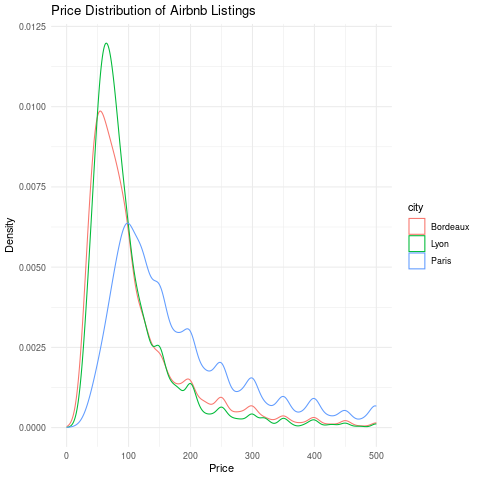

In [28]:
%%R

# Load necessary libraries
library(utils)
library(ggplot2)
library(dplyr)

# Define the URLs of the CSV files
url_listings_paris <- "https://data.insideairbnb.com/france/ile-de-france/paris/2024-03-16/visualisations/listings.csv"
url_listings_bordeaux <- "https://data.insideairbnb.com/france/nouvelle-aquitaine/bordeaux/2024-03-23/visualisations/listings.csv"
url_listings_lyon <- "https://data.insideairbnb.com/france/auvergne-rhone-alpes/lyon/2024-03-23/visualisations/listings.csv"

# Read the CSV files from the URLs
paris <- read.csv(url_listings_paris)
bordeaux <- read.csv(url_listings_bordeaux)
lyon <- read.csv(url_listings_lyon)

# Add a column to indicate the city
paris$city <- 'Paris'
bordeaux$city <- 'Bordeaux'
lyon$city <- 'Lyon'

# Combine the data into a single data frame
combined_data <- bind_rows(paris, bordeaux, lyon)

# Convert the price column to numeric (assuming prices have a currency symbol)
combined_data$price <- as.numeric(gsub("[^0-9.]", "", combined_data$price))

# Plot the distributions
ggplot(combined_data, aes(x = price, color = city)) +
  geom_density() +
  xlim(0, 500) +  # Adjust the limits if necessary
  labs(title = "Price Distribution of Airbnb Listings", x = "Price", y = "Density") +
  theme_minimal()

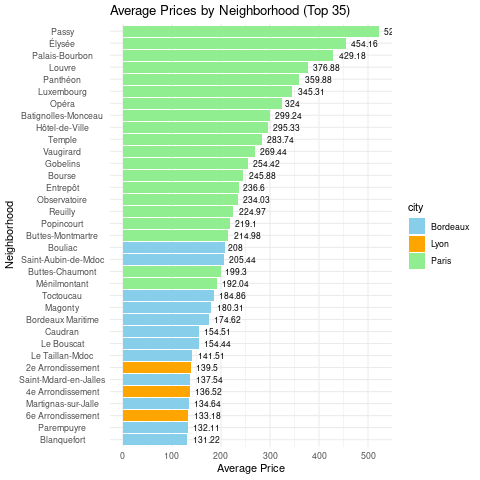

In [29]:
%%R

# Calculate average prices for each neighborhood in Bordeaux
average_prices_bordeaux <- bordeaux %>%
  group_by(neighbourhood) %>%
  summarise(average_price = mean(price, na.rm = TRUE))

# Calculate average prices for each neighborhood in Paris
average_prices_paris <- paris %>%
  group_by(neighbourhood) %>%
  summarise(average_price = mean(price, na.rm = TRUE))

# Calculate average prices for each neighborhood in Lyon
average_prices_lyon <- lyon %>%
  group_by(neighbourhood) %>%
  summarise(average_price = mean(price, na.rm = TRUE))

# Combine the average prices of neighborhoods from all cities
all_average_prices <- rbind(
  mutate(average_prices_bordeaux, city = "Bordeaux"),
  mutate(average_prices_paris, city = "Paris"),
  mutate(average_prices_lyon, city = "Lyon")
)

# Order neighborhoods by average price in descending order
all_average_prices <- all_average_prices %>%
  arrange(desc(average_price))

# Select the top 25 neighborhoods by average price
top_25_neighborhoods <- head(all_average_prices, 35)

# Plot horizontal bar graph of average prices for each neighborhood in Bordeaux, Paris, and Lyon
ggplot(top_25_neighborhoods, aes(x = average_price, y = reorder(neighbourhood, average_price), fill = city)) +
  geom_bar(stat = "identity") +
  geom_text(aes(label = round(average_price, 2)), hjust = -0.2, size = 3) +  # Add text labels to the right of the bars
  labs(title = "Average Prices by Neighborhood (Top 35)",
       x = "Average Price",
       y = "Neighborhood") +
  scale_fill_manual(values = c("Bordeaux" = "skyblue", "Paris" = "lightgreen", "Lyon" = "orange")) +
  theme_minimal() +
  theme(axis.text.y = element_text(angle = 0, hjust = 0.5, vjust = 0.5))
